# Feature Selection

In [20]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [21]:
# Load the dataset
df = pd.read_csv("../../Datasets/Companies/SmallCompanies.csv")

df.head()

,unique_id,disbursement_date,loan_investment_amount,lender_insurance_premium,metro_type,LMI_type,revenue,full_time_employees,naics_code,jobs_created,lender_type_category,optional_primary_use_of_funds,optional_revenue_yr_confirmed,optional_stage,active_status,support_amount
0,AK_2013_VCP_1,3/1/2013,180000.0,0.0,Metro,Non-LMI,0.0,5.0,541511,3.0,Loan Fund,"Wages, Working Capital, & Professional Services",2014.0,Early Stage,Unknown,0.0
1,AK_2013_VCP_3,12/30/2013,265000.0,0.0,Metro,Non-LMI,0.0,7.0,541511,2.0,Loan Fund,"Wages, Working Capital, & Professional Services",2014.0,Early Stage,Unknown,0.0
2,AK_2014_VCP_1,4/11/2014,199500.0,0.0,Metro,Non-LMI,0.0,2.0,336612,8.0,Loan Fund,"Wages, Working Capital, & Professional Services",2014.0,Early Stage,Unknown,0.0
3,AK_2014_VCP_2,5/15/2014,125000.0,0.0,Metro,LMI,1494916.0,8.0,451110,8.0,Loan Fund,"Wages, Working Capital, & Professional Services",2014.0,Early Stage,Unknown,0.0
4,AK_2014_VCP_3,9/15/2014,120000.0,0.0,Metro,Non-LMI,41000.0,0.0,336612,0.0,Loan Fund,"Wages, Working Capital, & Professional Services",2014.0,Early Stage,Unknown,0.0


In [22]:
print("Dataset dimensions:", df.shape)

Dataset dimensions: (18584, 16)


In [23]:
# Get concise summary of the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18584 entries, 0 to 18583
Data columns (total 16 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   unique_id                      18584 non-null  object 
 1   disbursement_date              18584 non-null  object 
 2   loan_investment_amount         18584 non-null  float64
 3   lender_insurance_premium       18584 non-null  float64
 4   metro_type                     18584 non-null  object 
 5   LMI_type                       18584 non-null  object 
 6   revenue                        18584 non-null  float64
 7   full_time_employees            18584 non-null  float64
 8   naics_code                     18584 non-null  int64  
 9   jobs_created                   18584 non-null  float64
 10  lender_type_category           18584 non-null  object 
 11  optional_primary_use_of_funds  18584 non-null  object 
 12  optional_revenue_yr_confirmed  18584 non-null 

In [24]:
# Filter out the categorical columns
categorical_columns = df.select_dtypes(include=['object']).columns

# Calculate the number of unique values for each categorical column
unique_counts_categorical = df[categorical_columns].nunique()

unique_counts_categorical

unique_id                        18563
disbursement_date                 1572
metro_type                           2
LMI_type                             2
lender_type_category                 6
optional_primary_use_of_funds        5
optional_stage                       5
active_status                       10
dtype: int64

In [25]:
df=df[df['active_status']!='Unknown']

In [26]:
different_active_statuses = df['active_status'].unique()

print(different_active_statuses)

['Did not attempt to confirm operations' 'Yes'
 'Attempted to confirm operations, but unable' 'Other' 'Sold' 'Exit'
 'Loss' 'Bankrupt' 'Moved']


## Encoding

In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4050 entries, 778 to 18583
Data columns (total 16 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   unique_id                      4050 non-null   object 
 1   disbursement_date              4050 non-null   object 
 2   loan_investment_amount         4050 non-null   float64
 3   lender_insurance_premium       4050 non-null   float64
 4   metro_type                     4050 non-null   object 
 5   LMI_type                       4050 non-null   object 
 6   revenue                        4050 non-null   float64
 7   full_time_employees            4050 non-null   float64
 8   naics_code                     4050 non-null   int64  
 9   jobs_created                   4050 non-null   float64
 10  lender_type_category           4050 non-null   object 
 11  optional_primary_use_of_funds  4050 non-null   object 
 12  optional_revenue_yr_confirmed  4050 non-null   flo

In [28]:
from sklearn.preprocessing import LabelEncoder

# Initialize LabelEncoder
label_encoder = LabelEncoder()

# Iterate through each categorical column
for column in df.select_dtypes(include=['object']):
    # Convert 'Yes' values to 1 and all others to 0 for 'active_status' column
    if column == 'active_status':
        df[column] = df[column].apply(lambda x: 1 if x == 'Yes' else 0)
    else:
        # Apply label encoding to other categorical columns
        df[column] = label_encoder.fit_transform(df[column])

df.head()

,unique_id,disbursement_date,loan_investment_amount,lender_insurance_premium,metro_type,LMI_type,revenue,full_time_employees,naics_code,jobs_created,lender_type_category,optional_primary_use_of_funds,optional_revenue_yr_confirmed,optional_stage,active_status,support_amount
778,8,462,100000.0,0.0,0,1,2027806.00,12.0,541330,0.0,0,4,2014.0,0,0,80000.0
800,24,705,240000.0,0.0,0,0,1662422.00,2.0,238220,0.0,0,4,2014.0,0,0,180000.0
802,31,713,282000.0,0.0,0,0,268058.00,11.0,722511,1.0,0,4,2014.0,0,0,225600.0
832,48,683,50000.0,0.0,0,1,254153.58,4.0,487210,0.0,4,4,2014.0,0,0,25000.0
847,57,809,21500.0,0.0,0,1,0.00,1.0,453310,0.0,0,4,2014.0,0,0,17200.0


In [29]:
frequency = df['active_status'].value_counts()
frequency = frequency.reset_index()
frequency.columns = ['active_status', 'count']
print(frequency)

   active_status  count
0              1   2398
1              0   1652


## Standardization

In [30]:
from sklearn.preprocessing import StandardScaler

# Initialize StandardScaler
scaler = StandardScaler()

scaled_df = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)

scaled_df.head()

,unique_id,disbursement_date,loan_investment_amount,lender_insurance_premium,metro_type,LMI_type,revenue,full_time_employees,naics_code,jobs_created,lender_type_category,optional_primary_use_of_funds,optional_revenue_yr_confirmed,optional_stage,active_status,support_amount
0,-1.725011,-0.512192,-0.315060,-0.198289,-0.4492,0.709858,0.035271,2.041887,0.174757,-0.396519,-1.166161,0.521336,-0.43048,-0.326299,-1.204813,0.134016
1,-1.711322,0.153605,-0.208173,-0.198289,-0.4492,-1.408732,0.020824,-0.558458,-1.671985,-0.396519,-1.166161,0.521336,-0.43048,-0.326299,-1.204813,0.664893
2,-1.705334,0.175524,-0.176107,-0.198289,-0.4492,-1.408732,-0.034310,1.781853,1.278630,-0.313751,-1.166161,0.521336,-0.43048,-0.326299,-1.204813,0.906973
3,-1.690790,0.093327,-0.353234,-0.198289,-0.4492,0.709858,-0.034859,-0.038389,-0.154977,-0.396519,1.300777,0.521336,-0.43048,-0.326299,-1.204813,-0.157967
4,-1.683090,0.438555,-0.374993,-0.198289,-0.4492,0.709858,-0.044909,-0.818492,-0.361517,-0.396519,-1.166161,0.521336,-0.43048,-0.326299,-1.204813,-0.199375


## PCA

In [ ]:
from sklearn.decomposition import PCA

# Initialize PCA with the number of components you want
pca = PCA(n_components=16)

# Fit PCA to the scaled data
pca.fit(scaled_df)

# Transform the data to the new feature space
transformed_data = pca.transform(scaled_df)

# Convert the transformed data to a DataFrame
selected_features = pd.DataFrame(transformed_data, columns=[f'PC{i}' for i in range(1, 17)])





,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16
0,2.700995,-0.135875,0.614188,-0.186165,0.871790,-0.087970,0.555908,0.232314,-1.316987,-0.713313,0.008874,0.093851,0.397433,-0.600760,0.401669,-0.211612
1,2.293900,-0.586320,0.317396,-0.471982,-0.341315,-1.079444,0.543717,-0.106121,1.655900,0.990006,-0.496755,-0.421545,0.241737,-0.581805,0.404843,-0.279562
2,2.663584,0.052054,0.881978,-0.461578,-1.188266,-0.002519,1.679214,-0.453097,-1.192579,-0.019556,0.137256,0.212075,0.263154,-0.424932,0.036932,-0.199519
3,1.434793,-1.318897,0.149692,-0.524932,-0.035512,0.517731,-0.706228,0.890411,0.252445,-0.620143,-0.222552,0.617968,-0.184474,-0.579495,0.031688,0.863575
4,2.089076,-0.474958,-0.239104,-0.103125,0.000484,0.203874,-1.015205,0.247049,0.301955,0.533284,-0.541914,-0.350322,0.290250,-1.019120,0.643439,-0.407117
5,1.541980,-1.198818,-0.060321,-0.386363,-0.205865,0.309944,-1.053992,0.829691,0.471631,-0.159170,-0.324994,0.317565,-0.042125,-0.785029,0.244765,0.511664
6,2.237656,-0.518157,0.128863,-0.439478,-1.023541,-0.424836,0.606727,-0.221130,0.725577,0.792318,-0.206520,-0.339123,0.256285,-0.774486,0.417225,-0.340666
7,1.621035,-1.129330,0.164017,-0.324187,-0.268298,0.032457,-0.980713,0.939586,0.184456,-0.310247,-0.080202,0.421732,0.059459,-0.720054,0.272363,0.537407
8,1.262964,-1.568678,-0.049366,-0.813394,-1.739904,0.271225,0.254324,0.404484,0.892371,-0.001588,0.155544,0.421852,-0.215077,-0.673812,0.003975,0.797045
9,2.042015,-0.802765,1.342794,-0.591002,-1.030071,-0.874031,1.423709,0.475757,-0.570859,-0.945542,1.147748,0.868405,0.326833,-0.177036,0.163481,0.700164


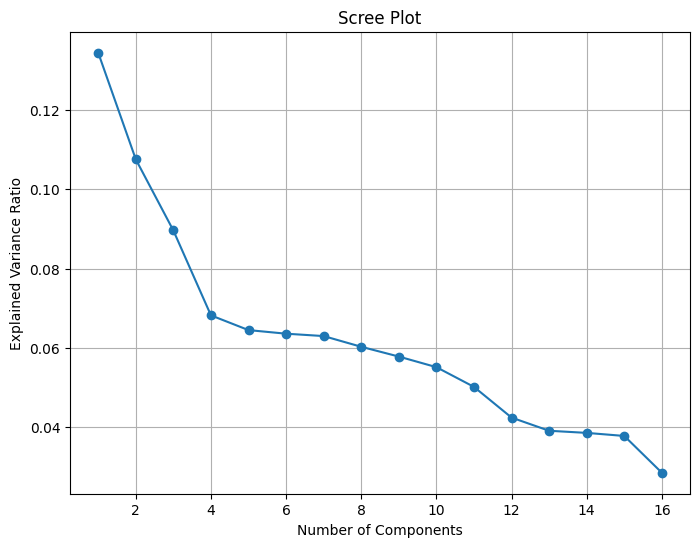

In [32]:
# Scree plot
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(pca.explained_variance_ratio_) + 1), pca.explained_variance_ratio_, marker='o', linestyle='-')
plt.xlabel('Number of Components')
plt.ylabel('Explained Variance Ratio')
plt.title('Scree Plot')
plt.grid(True)
plt.show()

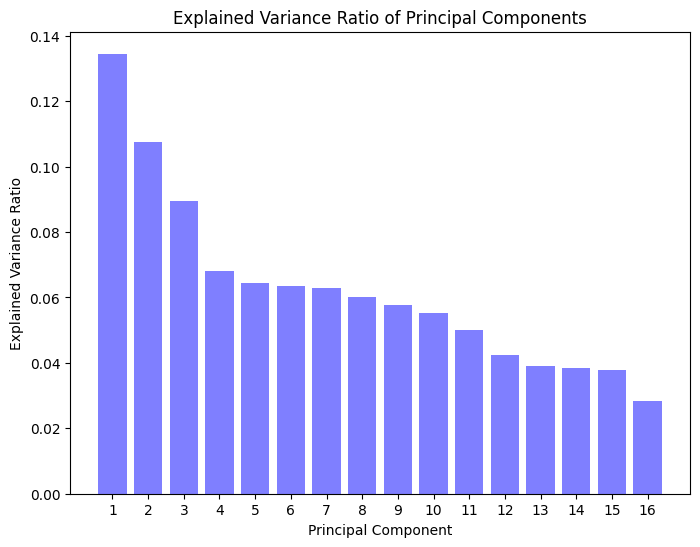

In [33]:
import matplotlib.pyplot as plt

# Plot the explained variance ratio
plt.figure(figsize=(8, 6))
plt.bar(range(1, pca.n_components_ + 1), pca.explained_variance_ratio_, color='blue', alpha=0.5)
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance Ratio of Principal Components')
plt.xticks(range(1, pca.n_components_ + 1))
plt.show()


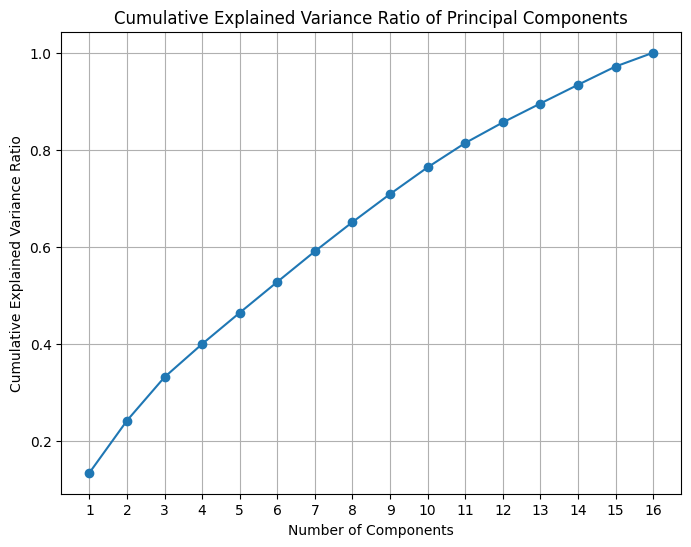

In [34]:

# Assuming pca is your PCA object
explained_variance_ratio_cumulative = np.cumsum(pca.explained_variance_ratio_)

# Plot the cumulative explained variance ratio
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(explained_variance_ratio_cumulative) + 1), explained_variance_ratio_cumulative, marker='o', linestyle='-')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Cumulative Explained Variance Ratio of Principal Components')
plt.xticks(range(1, len(explained_variance_ratio_cumulative) + 1))
plt.grid(True)
plt.show()


In [35]:
from sklearn.model_selection import train_test_split
#Split your data into features (X) and target variable (y)
X = scaled_df.drop(columns=['active_status'])  
y = df['active_status'] 

# Split your data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [36]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import itertools
import datetime

# List to store results
results = []

# Calculate total number of combinations
total_combinations = sum(len(list(itertools.combinations(X.columns, r))) for r in range(1, 7))

# Initialize counter for tracking progress
progress_counter = 0

# Loop through all possible combinations of features
for r in range(1, 7):  # considering combinations of 1 to 6 features
    feature_combinations = list(itertools.combinations(X.columns, r))
    for features in feature_combinations:
        # Logistic Regression
        lr_model = LogisticRegression()
        lr_model.fit(X_train[list(features)], y_train)
        lr_pred = lr_model.predict(X_test[list(features)])
        
        # Calculate evaluation metrics
        lr_accuracy = accuracy_score(y_test, lr_pred)
        lr_precision = precision_score(y_test, lr_pred)
        lr_recall = recall_score(y_test, lr_pred)
        lr_f1 = f1_score(y_test, lr_pred)

        for feature in features:
            results.append({
                'Feature': ', '.join(features),
                'Logistic Regression Accuracy': lr_accuracy,
                'Logistic Regression Precision': lr_precision,
                'Logistic Regression Recall': lr_recall,
                'Logistic Regression F1 Score': lr_f1
            })
        # Update progress
        progress_counter += 1
        print(f"Progress: {progress_counter}/{total_combinations}")

# Convert results to DataFrame for analysis
results_df = pd.DataFrame(results)
pd.set_option('display.max_rows', None)  # Display all rows without truncation
print(results_df)


# Save DataFrame to a CSV file with current date in the filename
results_df.to_csv(f"logistic_regression_results_SE.csv", index=False)

print(f"Results saved to 'logistic_regression_results_SE.csv'.")


Progress: 1/9948
Progress: 2/9948
Progress: 3/9948
Progress: 4/9948
Progress: 5/9948
Progress: 6/9948
Progress: 7/9948
Progress: 8/9948
Progress: 9/9948
Progress: 10/9948
Progress: 11/9948
Progress: 12/9948
Progress: 13/9948
Progress: 14/9948
Progress: 15/9948
Progress: 16/9948
Progress: 17/9948
Progress: 18/9948
Progress: 19/9948
Progress: 20/9948
Progress: 21/9948
Progress: 22/9948
Progress: 23/9948
Progress: 24/9948
Progress: 25/9948
Progress: 26/9948
Progress: 27/9948
Progress: 28/9948
Progress: 29/9948
Progress: 30/9948
Progress: 31/9948
Progress: 32/9948
Progress: 33/9948
Progress: 34/9948
Progress: 35/9948
Progress: 36/9948
Progress: 37/9948
Progress: 38/9948
Progress: 39/9948
Progress: 40/9948
Progress: 41/9948
Progress: 42/9948
Progress: 43/9948
Progress: 44/9948
Progress: 45/9948
Progress: 46/9948
Progress: 47/9948
Progress: 48/9948
Progress: 49/9948
Progress: 50/9948
Progress: 51/9948
Progress: 52/9948
Progress: 53/9948
Progress: 54/9948
Progress: 55/9948
Progress: 56/9948
P

In [37]:
import itertools
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import pandas as pd
import datetime

# List to store results
results = []

# Calculate total number of combinations
total_combinations = sum(len(list(itertools.combinations(X.columns, r))) for r in range(1, 7))

# Initialize counter for tracking progress
progress_counter = 0

# Loop through all possible combinations of features
for r in range(1, 7):  # considering combinations of 1 to 6 features
    feature_combinations = list(itertools.combinations(X.columns, r))
    for features in feature_combinations:
        # XGBoost Classifier
        xgb_model = XGBClassifier()
        xgb_model.fit(X_train[list(features)], y_train)
        xgb_pred = xgb_model.predict(X_test[list(features)])
        
        # Calculate evaluation metrics
        xgb_accuracy = accuracy_score(y_test, xgb_pred)
        xgb_precision = precision_score(y_test, xgb_pred)
        xgb_recall = recall_score(y_test, xgb_pred)
        xgb_f1 = f1_score(y_test, xgb_pred)

        # Store results
        for feature in features:
            results.append({
                'Feature': ', '.join(features),
                'XGBoost Accuracy': xgb_accuracy,
                'XGBoost Precision': xgb_precision,
                'XGBoost Recall': xgb_recall,
                'XGBoost F1 Score': xgb_f1
            })
        
        # Update progress
        progress_counter += 1
        print(f"Progress: {progress_counter}/{total_combinations}")

# Convert results to DataFrame for analysis
results_df = pd.DataFrame(results)


# Save DataFrame to a CSV file with current date in the filename
results_df.to_csv(f"xgboost_results_SE.csv", index=False)

print(f"Results saved to 'xgboost_results_SE.csv'.")


Progress: 1/9948
Progress: 2/9948
Progress: 3/9948
Progress: 4/9948
Progress: 5/9948
Progress: 6/9948
Progress: 7/9948
Progress: 8/9948
Progress: 9/9948
Progress: 10/9948
Progress: 11/9948
Progress: 12/9948
Progress: 13/9948
Progress: 14/9948
Progress: 15/9948
Progress: 16/9948
Progress: 17/9948
Progress: 18/9948
Progress: 19/9948
Progress: 20/9948
Progress: 21/9948
Progress: 22/9948
Progress: 23/9948
Progress: 24/9948
Progress: 25/9948
Progress: 26/9948
Progress: 27/9948
Progress: 28/9948
Progress: 29/9948
Progress: 30/9948
Progress: 31/9948
Progress: 32/9948
Progress: 33/9948
Progress: 34/9948
Progress: 35/9948
Progress: 36/9948
Progress: 37/9948
Progress: 38/9948
Progress: 39/9948
Progress: 40/9948
Progress: 41/9948
Progress: 42/9948
Progress: 43/9948
Progress: 44/9948
Progress: 45/9948
Progress: 46/9948
Progress: 47/9948
Progress: 48/9948
Progress: 49/9948
Progress: 50/9948
Progress: 51/9948
Progress: 52/9948
Progress: 53/9948
Progress: 54/9948
Progress: 55/9948
Progress: 56/9948
P

In [39]:
import itertools
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import pandas as pd
import datetime

# List to store results
results = []

# Calculate total number of combinations
total_combinations = sum(len(list(itertools.combinations(X.columns, r))) for r in range(1, 7))

# Initialize counter for tracking progress
progress_counter = 0

# Loop through all possible combinations of features
for r in range(1, 7):  # considering combinations of 1 to 6 features
    feature_combinations = list(itertools.combinations(X.columns, r))
    for features in feature_combinations:
       # Random Forest Classifier
        rf_model = RandomForestClassifier()
        rf_model.fit(X_train[list(features)], y_train)
        rf_pred = rf_model.predict(X_test[list(features)])
        rf_accuracy = accuracy_score(y_test, rf_pred)
        rf_precision = precision_score(y_test, rf_pred)
        rf_recall = recall_score(y_test, rf_pred)
        rf_f1 = f1_score(y_test, rf_pred)
        
        # Store results
        for feature in features:
            results.append({
                'Feature': ', '.join(features),
                'Random Forest Accuracy': rf_accuracy,
                'Random Forest Precision': rf_precision,
                'Random Forest Recall': rf_recall,
                'Random Forest F1 Score': rf_f1
            })

        # Update progress
        progress_counter += 1
        print(f"Progress: {progress_counter}/{total_combinations}")

# Convert results to DataFrame for analysis
results_df = pd.DataFrame(results)
pd.set_option('display.max_rows', None)  # Display all rows without truncation
print(results_df)


# Save DataFrame to a CSV file with current date in the filename
results_df.to_csv(f"random_forest_results_SE.csv", index=False)

print(f"Results saved to 'random_forest_results_SE.csv'.")


Progress: 1/9948
Progress: 2/9948
Progress: 3/9948
Progress: 4/9948
Progress: 5/9948
Progress: 6/9948
Progress: 7/9948
Progress: 8/9948
Progress: 9/9948
Progress: 10/9948
Progress: 11/9948
Progress: 12/9948
Progress: 13/9948
Progress: 14/9948
Progress: 15/9948
Progress: 16/9948
Progress: 17/9948
Progress: 18/9948
Progress: 19/9948
Progress: 20/9948
Progress: 21/9948
Progress: 22/9948
Progress: 23/9948
Progress: 24/9948
Progress: 25/9948
Progress: 26/9948
Progress: 27/9948
Progress: 28/9948
Progress: 29/9948
Progress: 30/9948
Progress: 31/9948
Progress: 32/9948
Progress: 33/9948
Progress: 34/9948
Progress: 35/9948
Progress: 36/9948
Progress: 37/9948
Progress: 38/9948
Progress: 39/9948
Progress: 40/9948
Progress: 41/9948
Progress: 42/9948
Progress: 43/9948
Progress: 44/9948
Progress: 45/9948
Progress: 46/9948
Progress: 47/9948
Progress: 48/9948
Progress: 49/9948
Progress: 50/9948
Progress: 51/9948
Progress: 52/9948
Progress: 53/9948
Progress: 54/9948
Progress: 55/9948
Progress: 56/9948
P

In [40]:
import itertools
import pandas as pd
import datetime
import tensorflow as tf
from tensorflow.keras.models import Sequential 
from tensorflow.keras.layers import Dense

# List to store results
results = []

# Calculate total number of combinations
total_combinations = sum(len(list(itertools.combinations(X.columns, r))) for r in range(1, 7))

# Initialize counter for tracking progress
progress_counter = 0

# Loop through all possible combinations of features
for r in range(1, 7):  # considering combinations of 1 to 6 features
    feature_combinations = list(itertools.combinations(X.columns, r))
    for features in feature_combinations:
        # Define a simple neural network model
        model = Sequential([
            Dense(64, activation='relu', input_shape=(len(features),)),
            Dense(32, activation='relu'),
            Dense(1, activation='sigmoid')
        ])

        # Compile the model
        model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

        # Train the model
        model.fit(X_train[list(features)], y_train, epochs=10, batch_size=32, verbose=0)

        # Evaluate the model
        nn_accuracy = model.evaluate(X_test[list(features)], y_test, verbose=0)[1]

        # Store results
        for feature in features:
            results.append({
                'Feature': ', '.join(features),
                'Neural Network Accuracy': nn_accuracy
            })
        
        # Update progress
        progress_counter += 1
        print(f"Progress: {progress_counter}/{total_combinations}")

# Convert results to DataFrame for analysis
results_df = pd.DataFrame(results)
print(results_df)


# Save DataFrame to a CSV file with current date in the filename
results_df.to_csv(f"NN_results_SE.csv", index=False)

print(f"Results saved to 'NN_results_SE.csv'.")







Progress: 1/9948
Progress: 2/9948
Progress: 3/9948
Progress: 4/9948
Progress: 5/9948
Progress: 6/9948
Progress: 7/9948
Progress: 8/9948
Progress: 9/9948
Progress: 10/9948
Progress: 11/9948
Progress: 12/9948
Progress: 13/9948
Progress: 14/9948
Progress: 15/9948
Progress: 16/9948
Progress: 17/9948
Progress: 18/9948
Progress: 19/9948
Progress: 20/9948
Progress: 21/9948
Progress: 22/9948
Progress: 23/9948
Progress: 24/9948
Progress: 25/9948
Progress: 26/9948
Progress: 27/9948
Progress: 28/9948
Progress: 29/9948
Progress: 30/9948
Progress: 31/9948
Progress: 32/9948
Progress: 33/9948
Progress: 34/9948
Progress: 35/9948
Progress: 36/9948
Progress: 37/9948
Progress: 38/9948
Progress: 39/9948
Progress: 40/9948
Progress: 41/9948
Progress: 42/9948
Progress: 43/9948
Progress: 44/9948
Progress: 45/9948
Progress: 46/9948
Progress: 47/9948
Progress: 48/9948
Progress: 49/9948
Progress: 50/9948
Progress: 51/9948
Progress: 52/9948
Progress: 53/9948
Progress: 54/9948
Progress: 55/9948
Progress: 56/9

In [48]:
# Load results from CSV files
nn_results_df = pd.read_csv("NN_results_SE.csv")
rf_results_df = pd.read_csv("random_forest_results_SE.csv")
lr_results_df = pd.read_csv("logistic_regression_results_SE.csv")
gb_results_df = pd.read_csv("xgboost_results_SE.csv") 

# Function to get top 10 combinations with best evaluations
def get_top_10_combinations(results_df, model_name):
    # Sort results by evaluation metric (e.g., accuracy)
    sorted_results_df = results_df.sort_values(by=f'{model_name} Accuracy', ascending=False)
    # Get top 10 combinations
    top_10_combinations = sorted_results_df.head(10)
    return top_10_combinations

# Get top 10 combinations for each model
top_10_nn_combinations = get_top_10_combinations(nn_results_df, 'Neural Network')
top_10_rf_combinations = get_top_10_combinations(rf_results_df, 'Random Forest')
top_10_lr_combinations = get_top_10_combinations(lr_results_df, 'Logistic Regression')
top_10_gb_combinations = get_top_10_combinations(gb_results_df, 'XGBoost')  

# Print top 10 combinations for each model
print("Top 10 Neural Network Combinations:")
print(top_10_nn_combinations)

print("\nTop 10 Random Forest Combinations:")
print(top_10_rf_combinations)

print("\nTop 10 Logistic Regression Combinations:")
print(top_10_lr_combinations)

print("\nTop 10 Gradient Boosting Combinations:")
print(top_10_gb_combinations)


Top 10 Neural Network Combinations:
                                                 Feature  \
29990  unique_id, lender_insurance_premium, metro_typ...   
29989  unique_id, lender_insurance_premium, metro_typ...   
29988  unique_id, lender_insurance_premium, metro_typ...   
29987  unique_id, lender_insurance_premium, metro_typ...   
29986  unique_id, lender_insurance_premium, metro_typ...   
29985  unique_id, lender_insurance_premium, metro_typ...   
30012  unique_id, lender_insurance_premium, metro_typ...   
30014  unique_id, lender_insurance_premium, metro_typ...   
30011  unique_id, lender_insurance_premium, metro_typ...   
30013  unique_id, lender_insurance_premium, metro_typ...   

       Neural Network Accuracy  
29990                 0.890123  
29989                 0.890123  
29988                 0.890123  
29987                 0.890123  
29986                 0.890123  
29985                 0.890123  
30012                 0.888889  
30014                 0.888889  
30011 

In [49]:
# Open a text file for writing
with open("evaluation_of_small_enterprises.txt", "w") as file:
    # Write top 10 Neural Network combinations
    file.write("Top 10 Neural Network Combinations:\n")
    file.write(top_10_nn_combinations.to_string(index=False))
    file.write("\n\n")
    
    # Write top 10 Random Forest combinations
    file.write("Top 10 Random Forest Combinations:\n")
    file.write(top_10_rf_combinations.to_string(index=False))
    file.write("\n\n")

    # Write top 10 Logistic Regression combinations
    file.write("Top 10 Logistic Regression Combinations:\n")
    file.write(top_10_lr_combinations.to_string(index=False))
    file.write("\n\n")

    # Write top 10 Gradient Boosting Combinations
    file.write("Top 10 Gradient Boosting Combinations:\n")
    file.write(top_10_gb_combinations.to_string(index=False))

print("Results saved to 'evaluation_of_small_enterprises.txt'.")



Results saved to 'evaluation_of_small_enterprises.txt'.


: 